<a href="https://colab.research.google.com/github/Rugiyya1/Churn_prediction/blob/main/Churn_prediction_Video_stream_platform.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Import required packages

#Import libraries
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
pd.set_option('display.max_columns', None)



# Machine Learning / Classification packages
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import train_test_split
from sklearn.dummy import DummyClassifier

# Visualization Packages
from matplotlib import pyplot as plt
import plotly.express as px #for visualization
import seaborn as sns
%matplotlib inline

In [3]:
pip install category_encoders

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.9/81.9 kB 2.0 MB/s eta 0:00:00


In [4]:
# Import any other packages you may want to use
import warnings
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error

from sklearn.metrics import classification_report, confusion_matrix

from IPython.display import display
from pandas.api.types import CategoricalDtype
from category_encoders import MEstimateEncoder
from sklearn.feature_selection import mutual_info_regression
from sklearn.model_selection import KFold, cross_val_score

# Data loading and pre-processing

In [5]:
train_df = pd.read_csv("train.csv")
print('train_df Shape:', train_df.shape)
train_df.head().T

train_df Shape: (249685, 21)


,0,1,2,3,4
AccountAge,20,57,73,32,57
MonthlyCharges,11.055215,5.175208,12.106657,7.263743,16.953078
TotalCharges,221.104302,294.986882,883.785952,232.439774,966.325422
SubscriptionType,Premium,Basic,Basic,Basic,Premium
PaymentMethod,Mailed check,Credit card,Mailed check,Electronic check,Electronic check
PaperlessBilling,No,Yes,Yes,No,Yes
ContentType,Both,Movies,Movies,TV Shows,TV Shows
MultiDeviceAccess,No,No,No,No,No
DeviceRegistered,Mobile,Tablet,Computer,Tablet,TV
ViewingHoursPerWeek,36.758104,32.450568,7.39516,27.960389,20.083397


In [ ]:
train_df.columns

Index(['AccountAge', 'MonthlyCharges', 'TotalCharges', 'SubscriptionType',
       'PaymentMethod', 'PaperlessBilling', 'ContentType', 'MultiDeviceAccess',
       'DeviceRegistered', 'ViewingHoursPerWeek', 'AverageViewingDuration',
       'ContentDownloadsPerMonth', 'GenrePreference', 'UserRating',
       'SupportTicketsPerMonth', 'Gender', 'WatchlistSize', 'ParentalControl',
       'SubtitlesEnabled', 'CustomerID', 'Churn'],
      dtype='object')

In [6]:
test_df = pd.read_csv("test.csv")
print('test_df Shape:', test_df.shape)
test_df.head()

test_df Shape: (104480, 20)


,AccountAge,MonthlyCharges,TotalCharges,SubscriptionType,PaymentMethod,PaperlessBilling,ContentType,MultiDeviceAccess,DeviceRegistered,ViewingHoursPerWeek,AverageViewingDuration,ContentDownloadsPerMonth,GenrePreference,UserRating,SupportTicketsPerMonth,Gender,WatchlistSize,ParentalControl,SubtitlesEnabled,CustomerID
0,38,17.869374,679.036195,Premium,Mailed check,No,TV Shows,No,TV,29.126308,122.274031,42,Comedy,3.522724,2,Male,23,No,No,O1W6BHP6RM
1,77,9.912854,763.289768,Basic,Electronic check,Yes,TV Shows,No,TV,36.873729,57.093319,43,Action,2.021545,2,Female,22,Yes,No,LFR4X92X8H
2,5,15.019011,75.095057,Standard,Bank transfer,No,TV Shows,Yes,Computer,7.601729,140.414001,14,Sci-Fi,4.806126,2,Female,22,No,Yes,QM5GBIYODA
3,88,15.357406,1351.451692,Standard,Electronic check,No,Both,Yes,Tablet,35.586430,177.002419,14,Comedy,4.943900,0,Female,23,Yes,Yes,D9RXTK2K9F
4,91,12.406033,1128.949004,Standard,Credit card,Yes,TV Shows,Yes,Tablet,23.503651,70.308376,6,Drama,2.846880,6,Female,0,No,No,ENTCCHR1LR


#EDA

In [ ]:
#train_df.info()

In [ ]:
#Get overview of the data
def dataoveriew(df, message):
    print(f'{message}:\n')
    print('Number of rows: ', df.shape[0])
    print("\nNumber of features:", df.shape[1])
    print("\nData Features:")
    print(df.columns.tolist())
    print("\nMissing values:", df.isnull().sum().values.sum())
    print("\nUnique values:")
    print(df.nunique())

dataoveriew(train_df, 'Overview of the train dataset')

Overview of the train dataset:

Number of rows:  243787

Number of features: 20

Data Features:
['AccountAge', 'MonthlyCharges', 'TotalCharges', 'SubscriptionType', 'PaymentMethod', 'PaperlessBilling', 'ContentType', 'MultiDeviceAccess', 'DeviceRegistered', 'ViewingHoursPerWeek', 'AverageViewingDuration', 'ContentDownloadsPerMonth', 'GenrePreference', 'UserRating', 'SupportTicketsPerMonth', 'Gender', 'WatchlistSize', 'ParentalControl', 'SubtitlesEnabled', 'Churn']

Missing values: 0

Unique values:
AccountAge                     119
MonthlyCharges              243787
TotalCharges                243787
SubscriptionType                 3
PaymentMethod                    4
PaperlessBilling                 2
ContentType                      3
MultiDeviceAccess                2
DeviceRegistered                 4
ViewingHoursPerWeek         243787
AverageViewingDuration      243787
ContentDownloadsPerMonth        50
GenrePreference                  5
UserRating                  243787
Suppor

In [ ]:
## describe cat var
train_df.describe(include='object').T

,count,unique,top,freq
SubscriptionType,243787,3,Standard,81920
PaymentMethod,243787,4,Electronic check,61313
PaperlessBilling,243787,2,No,121980
ContentType,243787,3,Both,81737
MultiDeviceAccess,243787,2,No,122035
DeviceRegistered,243787,4,Computer,61147
GenrePreference,243787,5,Comedy,49060
Gender,243787,2,Female,121930
ParentalControl,243787,2,Yes,122085
SubtitlesEnabled,243787,2,Yes,122180


In [ ]:
#describe num variables
train_df.describe().T

,count,mean,std,min,25%,50%,75%,max
AccountAge,243787.0,60.083758,34.285143,1.000000,30.000000,60.000000,90.000000,119.000000
MonthlyCharges,243787.0,12.490695,4.327615,4.990062,8.738543,12.495555,16.238160,19.989957
TotalCharges,243787.0,750.741017,523.073273,4.991154,329.147027,649.878487,1089.317362,2378.723844
ViewingHoursPerWeek,243787.0,20.502179,11.243753,1.000065,10.763953,20.523116,30.219396,39.999723
AverageViewingDuration,243787.0,92.264061,50.505243,5.000547,48.382395,92.249992,135.908048,179.999275
ContentDownloadsPerMonth,243787.0,24.503513,14.421174,0.000000,12.000000,24.000000,37.000000,49.000000
UserRating,243787.0,3.002713,1.155259,1.000007,2.000853,3.002261,4.002157,4.999989
SupportTicketsPerMonth,243787.0,4.504186,2.872548,0.000000,2.000000,4.000000,7.000000,9.000000
WatchlistSize,243787.0,12.018508,7.193034,0.000000,6.000000,12.000000,18.000000,24.000000
Churn,243787.0,0.181232,0.385211,0.000000,0.000000,0.000000,0.000000,1.000000


In [ ]:
## Exploring target variable 'Churn'

target = train_df['Churn'].value_counts().to_frame()
target = target.reset_index()
target = target.rename(columns ={'index':'Category'})
fig =px.pie(target, values ='Churn', names ='Category', color_discrete_sequence =['green', 'red'],
            title ='Distribution of Churn')
fig.show()

In [ ]:
## Base accuarcy of the model is 81.9%

In [7]:
## Getting categorical columns

cat_cols = [col for col in train_df.columns if
           train_df[col].dtype =='object']

cat_cols

['SubscriptionType',
 'PaymentMethod',
 'PaperlessBilling',
 'ContentType',
 'MultiDeviceAccess',
 'DeviceRegistered',
 'GenrePreference',
 'Gender',
 'ParentalControl',
 'SubtitlesEnabled',
 'CustomerID']

In [8]:
## Exploring categorical variables

#Defining bar chart function
def bar(feature, df=train_df ):
    #Groupby the categorical feature
    temp_df = df.groupby([feature, 'Churn']).size().reset_index()
    temp_df = temp_df.rename(columns={0:'Count'})
    #Calculate the value counts of each distribution and it's corresponding Percentages
    value_counts_df = df[feature].value_counts().to_frame().reset_index()
    categories = [cat[1][0] for cat in value_counts_df.iterrows()]
    #Calculate the value counts of each distribution and it's corresponding Percentages
    num_list = [num[1][1] for num in value_counts_df.iterrows()]
    div_list = [element / sum(num_list) for element in num_list]
    percentage = [round(element * 100,1) for element in div_list]
    #Defining string formatting for graph annotation
    #Numeric section
    def num_format(list_instance):
        formatted_str = ''
        for index,num in enumerate(list_instance):
            if index < len(list_instance)-2:
                formatted_str=formatted_str+f'{num}%, ' #append to empty string(formatted_str)
            elif index == len(list_instance)-2:
                formatted_str=formatted_str+f'{num}% & '
            else:
                formatted_str=formatted_str+f'{num}%'
        return formatted_str
    #Categorical section
    def str_format(list_instance):
        formatted_str = ''
        for index, cat in enumerate(list_instance):
            if index < len(list_instance)-2:
                formatted_str=formatted_str+f'{cat}, '
            elif index == len(list_instance)-2:
                formatted_str=formatted_str+f'{cat} & '
            else:
                formatted_str=formatted_str+f'{cat}'
        return formatted_str
    #Running the formatting functions
    num_str = num_format(percentage)
    cat_str = str_format(categories)

    #Setting graph framework
    fig = px.bar(temp_df, x=feature, y='Count', color='Churn', title=f'Churn rate by {feature}', barmode="group", color_discrete_sequence=["green", "red"])
    fig.add_annotation(
                text=f'Value count of distribution of {cat_str} are<br>{num_str} percentage respectively.',
                align='left',
                showarrow=False,
                xref='paper',
                yref='paper',
                x=1.4,
                y=1.3,
                bordercolor='black',
                borderwidth=1)
    fig.update_layout(
        # margin space for the annotations on the right
        margin=dict(r=600),
    )

    return fig.show()

In [ ]:
#Gender feature plot
bar('Gender')
#SubscriptionType feature plot
bar('SubscriptionType')

In [ ]:
#ContentType feature plot
bar('ContentType')
#GenrePreference feature plot
bar('GenrePreference')

In [ ]:
#Patment method feature plot
bar('PaymentMethod')
#DeviceRegistered feature plot
bar('DeviceRegistered')

In [ ]:
bar('PaperlessBilling')
bar('ParentalControl')
bar('SubtitlesEnabled')

Insights : all features are evenly distributed with approximate percentage values.
The difference in churn rate of man is a slightly higher than woman.
Basic and Standard subscriptions have slightly higher churn than premimum.
Genre prefence and content types almost have similar churn rates.


In [ ]:
## Plotting numerical features
# Defining the histogram plotting function
def hist(feature):
    group_df = train_df.groupby([feature, 'Churn']).size().reset_index()
    group_df = group_df.rename(columns={0: 'Count'})
    fig = px.histogram(group_df, x=feature, y='Count', color='Churn', marginal='box', title=f'Churn rate frequency to {feature} distribution', color_discrete_sequence=["green", "red"])
    fig.show()

In [ ]:
hist('AccountAge')
hist('MonthlyCharges')
hist('TotalCharges')

Insights:  As visible from Account Age graph that, the churn rates are higher fow new users rather than old users. Churn rate deacreases while account age increases.   
Monthlycharges graph shows that churn rates increase when monthly charge increase. This suggests that discounts and promotions can be enticing reason for customers.



In [ ]:
hist('ViewingHoursPerWeek')
hist('AverageViewingDuration')

In [ ]:
hist('ContentDownloadsPerMonth')
hist('UserRating')
hist('SupportTicketsPerMonth')
hist('WatchlistSize')

Let’s bin the numeric features into three sections based on quantiles (low, medium, and high to get more information from it).

In [ ]:
#Create an empty dataframe
bin_df = pd.DataFrame()

#Update the binning dataframe
bin_df['AccountAge_bins'] =  pd.qcut(train_df['AccountAge'], q=3, labels= ['low', 'medium', 'high'])
bin_df['MonthlyCharges_bins'] =  pd.qcut(train_df['MonthlyCharges'], q=3, labels= ['low', 'medium', 'high'])
bin_df['AverageViewingDuration_bins'] =  pd.qcut(train_df['AverageViewingDuration'], q=3, labels= ['low', 'medium', 'high'])
bin_df['Churn'] = train_df['Churn']

#Plot the bar chart of the binned variables
bar('AccountAge_bins', bin_df)
bar('MonthlyCharges_bins', bin_df)
bar('AverageViewingDuration_bins', bin_df)

based on bins low account age, high monthly cahrges and low viewing duration have higher churn rates

#Data preprocessing

In [ ]:
# The customerID column isnt useful as the feature is used for identification of customers:

train_df.drop(['CustomerID'], axis=1, inplace=True)

In [ ]:
# Encode categorical features

#Defining the map function
def binary_map(feature):
    return feature.map({'Yes':1, 'No':0})

# Encoding gender category
train_df['Gender'] = train_df['Gender'].map({'Male':1, 'Female':0})

#Encoding other binary category
binary_list = ['PaperlessBilling', 'MultiDeviceAccess', 'ParentalControl', 'SubtitlesEnabled']
train_df[binary_list] = train_df[binary_list].apply(binary_map)

#Encoding the other categoric features with more than two categories
train_df = pd.get_dummies(train_df, drop_first=True)

<Axes: >

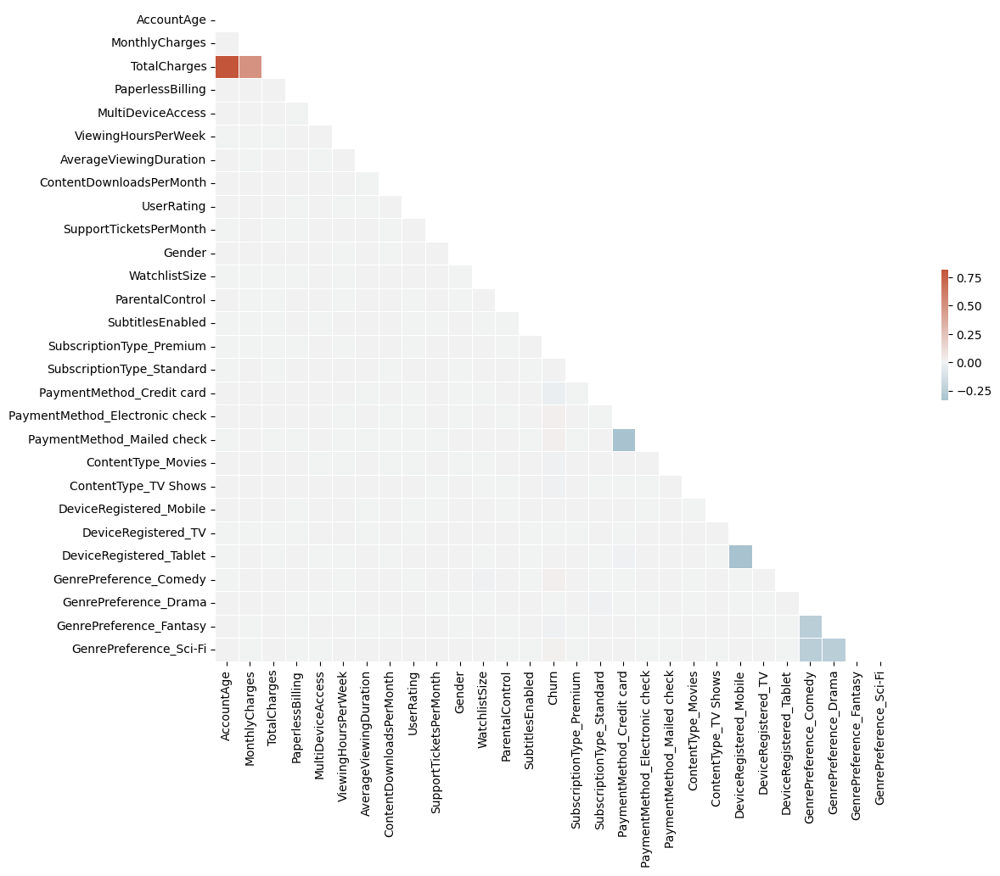

In [ ]:
## Checking correlation between features
#sns.set_theme(style='white')

corr =train_df.corr().drop('Churn')

mask = np.triu(np.ones_like(corr, dtype =bool))

f,ax = plt.subplots(figsize=(15, 10))

cmap =sns.diverging_palette(230,20, as_cmap =True)


sns.heatmap(corr, mask=mask, cmap=cmap, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .2}, annot=False, annot_kws={"fontsize":8})

Correlation measures the linear relationship between two variables. Features with high correlation are more linearly dependent and have almost the same effect on the dependent variable. So, when two features have a high correlation, we can drop one of them.

  In our case, correlatrion between features is very low and can be ignored.

Churn prediction is a binary classification problem, as customers either churn or are retained in a given period. Two questions need answering to guide model building:

1. Which features make customers churn or retain?
2. What are the most important features to train a model with high performance?

In [ ]:
#Let’s use the generalized linear model (GLM) to gain some statistics of the respective features with the target.
import statsmodels.api as sm
import statsmodels.formula.api as smf

In [ ]:
#Change variable name separators to '_'
all_columns = [column.replace(" ", "_").replace("(", "_").replace(")", "_").replace("-", "_") for column in train_df.columns]

#Effect the change to the dataframe column names
train_df.columns = all_columns

#Prepare it for the GLM formula
glm_columns = [e for e in all_columns if e not in ['CustomerID', 'Churn']]
glm_columns = ' + '.join(map(str, glm_columns))

#Fiting it to the Generalized Linear Model
glm_model = smf.glm(formula=f'Churn ~ {glm_columns}', data=train_df, family=sm.families.Binomial())
res = glm_model.fit()
print(res.summary())

                 Generalized Linear Model Regression Results                  
Dep. Variable:                  Churn   No. Observations:               243787
Model:                            GLM   Df Residuals:                   243758
Model Family:                Binomial   Df Model:                           28
Link Function:                  Logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:            -1.0032e+05
Date:                Mon, 13 Nov 2023   Deviance:                   2.0063e+05
Time:                        15:14:24   Pearson chi2:                 2.41e+05
No. Iterations:                     6   Pseudo R-squ. (CS):             0.1162
Covariance Type:            nonrobust                                         
                                     coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------
Intercept   

For the first question, you should look at the (P>|z|) column. If the absolute p-value is smaller than 0.05, it means that the feature affects Churn in a statistically significant way.

The second question about feature importances can be answered by looking at the exponential coefficient values. The exponential coefficient estimates the expected change in churn through a given feature by a change of one unit.

In [ ]:
np.exp(res.params)

Intercept                         0.982640
AccountAge                        0.982412
MonthlyCharges                    1.069401
TotalCharges                      1.000036
PaperlessBilling                  0.997179
MultiDeviceAccess                 0.993142
ViewingHoursPerWeek               0.966544
AverageViewingDuration            0.991344
ContentDownloadsPerMonth          0.973469
UserRating                        1.056791
SupportTicketsPerMonth            1.091006
Gender                            1.040031
WatchlistSize                     1.008810
ParentalControl                   0.964755
SubtitlesEnabled                  0.937233
SubscriptionType_Premium          0.762514
SubscriptionType_Standard         0.904092
PaymentMethod_Credit_card         0.870914
PaymentMethod_Electronic_check    1.105475
PaymentMethod_Mailed_check        1.083526
ContentType_Movies                0.917390
ContentType_TV_Shows              0.922407
DeviceRegistered_Mobile           1.007525
DeviceRegis

This outputs the odd ratios. Values more than 1 indicate increased churn. Values less than 1 indicate that churn is happening less.

The range of all features should be normalized so that each feature contributes approximately proportionately to the final distance, so we do feature scaling.

In [ ]:
#feature scaling
from sklearn.preprocessing import MinMaxScaler
sc = MinMaxScaler()
train_df['AccountAge'] = sc.fit_transform(train_df[['AccountAge']])
data_df['MonthlyCharges'] = sc.fit_transform(data_df[['MonthlyCharges']])
data_df['TotalCharges'] = sc.fit_transform(data_df[['TotalCharges']])

<ipython-input-16-5696c605ed88>:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  train_df.corr()['Churn'].sort_values().drop("Churn").plot(kind = "barh", color='green');


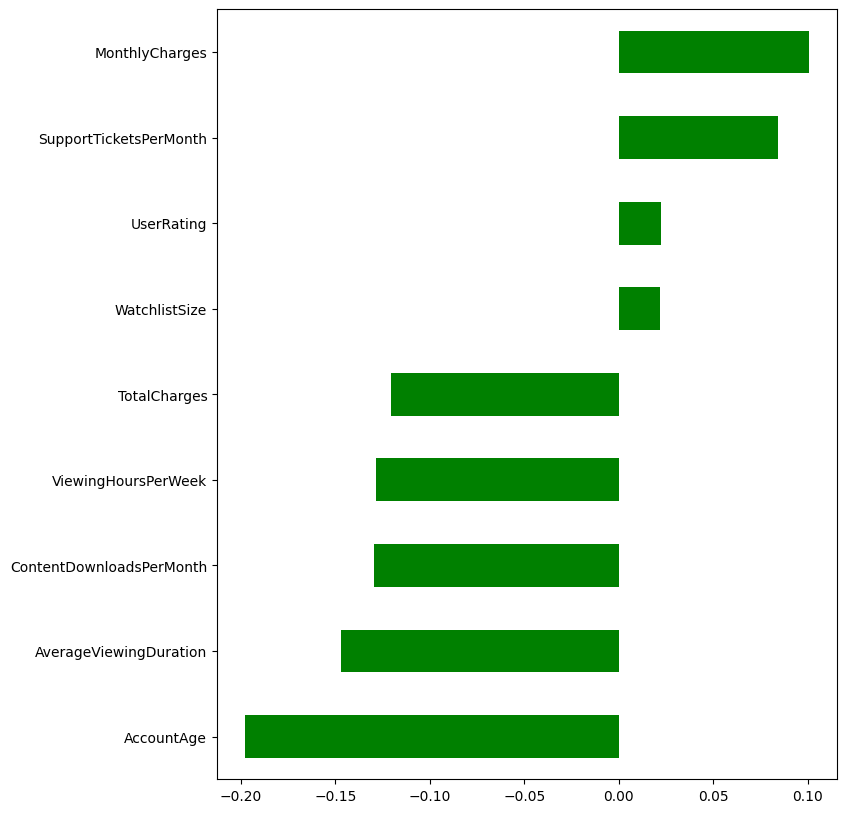

In [ ]:
# checking correlation of features with target
plt.figure(figsize = (8,10))
train_df.corr()['Churn'].sort_values().drop("Churn").plot(kind = "barh", color='green');

In [ ]:
#Insights based on EDA:
#- No missing values
#- Data is an imbalanced data
#- Correlations between features are quite low and acceptable
#- Dataset looks well distributed (no outliers treat required for now)


In [ ]:
## Train Test split

X = train_df.drop('Churn', axis=1)
y=train_df['Churn']

X_train, X_val, y_train, y_val = train_test_split(X,y, test_size =0.2, random_state=42)

In [ ]:
## Encoding

def encode(df):
    # Nominal categories
    for name in cat_cols:
        df[name] = df[name].astype("category")

    return df

In [ ]:
## Establish Baseline

from sklearn.model_selection import KFold, cross_val_score
from xgboost import XGBClassifier


def score_dataset(X, y, model=XGBClassifier()):
    # Label encoding for categoricals
    #
    # Label encoding is good for XGBoost and RandomForest, but one-hot
    # would be better for models like Lasso or Ridge. The `cat.codes`
    # attribute holds the category levels.
    for colname in X.select_dtypes(["category"]):
        X[colname] = X[colname].cat.codes
    # Metric for Housing competition is RMSLE (Root Mean Squared Log Error)
    log_y = np.log(y)
    score = cross_val_score(
        model, X, log_y, cv=5, scoring="neg_mean_squared_error",
    )
    score = -1 * score.mean()
    score = np.sqrt(score)
    return score

In [ ]:
X = train_df.copy()
y = X.pop("Churn")

baseline_score = score_dataset(X, y)
print(f"Baseline score: {baseline_score:.5f} RMSLE")

/usr/local/lib/python3.10/dist-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


ValueError: ignored

In [ ]:
## Transforming cat varib. to num var.

from sklearn.compose import make_column_transformer
from sklearn.preprocessing import OneHotEncoder


In [ ]:
one_enc = OneHotEncoder(handle_unknown ='ignore', sparse_output =False)

one_cols_train = pd.DataFrame(one_enc.fit_transform(X_train[cat_cols]))
one_cols_valid =pd.DataFrame(one_enc.transform(X_val[cat_cols]))

# One-hot encoding removed index; put it back
one_cols_train.index = X_train.index
one_cols_valid.index = X_val.index

In [ ]:
one_enc.get_feature_names_out()

array(['SubscriptionType_Basic', 'SubscriptionType_Premium',
       'SubscriptionType_Standard', 'PaymentMethod_Bank transfer',
       'PaymentMethod_Credit card', 'PaymentMethod_Electronic check',
       'PaymentMethod_Mailed check', 'PaperlessBilling_No',
       'PaperlessBilling_Yes', 'ContentType_Both', 'ContentType_Movies',
       'ContentType_TV Shows', 'MultiDeviceAccess_No',
       'MultiDeviceAccess_Yes', 'DeviceRegistered_Computer',
       'DeviceRegistered_Mobile', 'DeviceRegistered_TV',
       'DeviceRegistered_Tablet', 'GenrePreference_Action',
       'GenrePreference_Comedy', 'GenrePreference_Drama',
       'GenrePreference_Fantasy', 'GenrePreference_Sci-Fi',
       'Gender_Female', 'Gender_Male', 'ParentalControl_No',
       'ParentalControl_Yes', 'SubtitlesEnabled_No',
       'SubtitlesEnabled_Yes'], dtype=object)

In [ ]:
one_cols_train.columns =one_enc.get_feature_names_out()
one_cols_valid.columns = one_enc.get_feature_names_out()

In [ ]:
# Remove categorical columns (will replace with one-hot encoding)
num_X_train = X_train.drop(cat_cols, axis=1)
num_X_valid = X_val.drop(cat_cols, axis=1)

In [ ]:
# Add one-hot encoded columns to numerical features
one_X_train = pd.concat([num_X_train, one_cols_train], axis=1)
one_X_valid = pd.concat([num_X_valid, one_cols_valid], axis=1)

In [ ]:

# Ensure all columns have string type
one_X_train.columns = one_X_train.columns.astype(str)
one_X_valid.columns = one_X_valid.columns.astype(str)

In [ ]:
## SMOTE
from imblearn.over_sampling import SMOTE
smote = SMOTE(random_state = 42)

X_smote, y_smote = smote.fit_resample(one_X_train, y_train)

In [ ]:
X_smote.shape

(319274, 38)

In [ ]:
## checking model:
from sklearn.ensemble import RandomForestClassifier

check_model = RandomForestClassifier(n_estimators=50, random_state=1)

In [ ]:
mod1=check_model.fit(one_X_train, y_train)

In [ ]:
pred_1 = mod1.predict(one_X_valid)

In [ ]:
print(classification_report(y_val, pred_1))

              precision    recall  f1-score   support

           0       0.83      0.99      0.90     39968
           1       0.56      0.08      0.14      8790

    accuracy                           0.82     48758
   macro avg       0.70      0.53      0.52     48758
weighted avg       0.78      0.82      0.76     48758



In [ ]:
mod2=check_model.fit(X_smote, y_smote)

In [ ]:
X_smote.columns

Index(['AccountAge', 'MonthlyCharges', 'TotalCharges', 'ViewingHoursPerWeek',
       'AverageViewingDuration', 'ContentDownloadsPerMonth', 'UserRating',
       'SupportTicketsPerMonth', 'WatchlistSize', 'SubscriptionType_Basic',
       'SubscriptionType_Premium', 'SubscriptionType_Standard',
       'PaymentMethod_Bank transfer', 'PaymentMethod_Credit card',
       'PaymentMethod_Electronic check', 'PaymentMethod_Mailed check',
       'PaperlessBilling_No', 'PaperlessBilling_Yes', 'ContentType_Both',
       'ContentType_Movies', 'ContentType_TV Shows', 'MultiDeviceAccess_No',
       'MultiDeviceAccess_Yes', 'DeviceRegistered_Computer',
       'DeviceRegistered_Mobile', 'DeviceRegistered_TV',
       'DeviceRegistered_Tablet', 'GenrePreference_Action',
       'GenrePreference_Comedy', 'GenrePreference_Drama',
       'GenrePreference_Fantasy', 'GenrePreference_Sci-Fi', 'Gender_Female',
       'Gender_Male', 'ParentalControl_No', 'ParentalControl_Yes',
       'SubtitlesEnabled_No', 'Subtitl

In [ ]:
pred_2 = mod2.predict(one_X_valid)

In [ ]:
print(classification_report(y_val, pred_2))

              precision    recall  f1-score   support

           0       0.83      0.99      0.90     39968
           1       0.55      0.06      0.11      8790

    accuracy                           0.82     48758
   macro avg       0.69      0.53      0.51     48758
weighted avg       0.78      0.82      0.76     48758



In [ ]:
## Mutual info
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.feature_selection import mutual_info_regression

# Set Matplotlib defaults
plt.style.use("seaborn-whitegrid")
plt.rc("figure", autolayout=True)
plt.rc(
    "axes",
    labelweight="bold",
    labelsize="large",
    titleweight="bold",
    titlesize=14,
    titlepad=10,
)

# Utility functions
def make_mi_scores(X, y):
    X = X.copy()
    for colname in X.select_dtypes(["object", "category"]):
        X[colname], _ = X[colname].factorize()
    # All discrete features should now have integer dtypes
    discrete_features = [pd.api.types.is_integer_dtype(t) for t in X.dtypes]
    mi_scores = mutual_info_regression(X, y, discrete_features=discrete_features, random_state=0)
    mi_scores = pd.Series(mi_scores, name="MI Scores", index=X.columns)
    mi_scores = mi_scores.sort_values(ascending=False)
    return mi_scores


<ipython-input-22-9a5b2e67ee4c>:9: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn-whitegrid")


In [ ]:
mi_scores = make_mi_scores(X_smote, y_smote)

In [ ]:
print(mi_scores)

SubtitlesEnabled_Yes              0.159873
PaperlessBilling_Yes              0.158798
SubtitlesEnabled_No               0.158648
Gender_Male                       0.157393
ParentalControl_Yes               0.157011
PaperlessBilling_No               0.156824
ParentalControl_No                0.156517
Gender_Female                     0.155956
MultiDeviceAccess_Yes             0.155706
MultiDeviceAccess_No              0.155125
SubscriptionType_Basic            0.143673
ContentType_Both                  0.142874
SubscriptionType_Standard         0.140202
ContentType_Movies                0.139467
ContentType_TV Shows              0.139424
SubscriptionType_Premium          0.138102
PaymentMethod_Electronic check    0.123219
PaymentMethod_Mailed check        0.121367
DeviceRegistered_Tablet           0.120708
PaymentMethod_Bank transfer       0.120420
DeviceRegistered_Mobile           0.119428
DeviceRegistered_Computer         0.119060
DeviceRegistered_TV               0.117917
PaymentMeth

In [ ]:
X_smote['total_view_duration'] = X_smote['AverageViewingDuration']* X_smote['AccountAge']

In [ ]:
mi_scores = make_mi_scores(X_smote, y_smote)

In [ ]:
print(mi_scores)

SubtitlesEnabled_No               0.158994
SubtitlesEnabled_Yes              0.158183
Gender_Female                     0.157013
PaperlessBilling_No               0.156887
MultiDeviceAccess_No              0.156818
MultiDeviceAccess_Yes             0.156625
ParentalControl_No                0.156320
ParentalControl_Yes               0.156050
PaperlessBilling_Yes              0.155893
Gender_Male                       0.155871
SubscriptionType_Basic            0.144529
ContentType_Both                  0.143557
ContentType_TV Shows              0.140981
SubscriptionType_Premium          0.140383
SubscriptionType_Standard         0.138981
ContentType_Movies                0.138168
PaymentMethod_Mailed check        0.122863
PaymentMethod_Electronic check    0.122652
DeviceRegistered_Tablet           0.122061
DeviceRegistered_Computer         0.120980
PaymentMethod_Bank transfer       0.120735
DeviceRegistered_Mobile           0.119156
DeviceRegistered_TV               0.117327
PaymentMeth

In [ ]:
features_d =['WatchlistSize', 'MonthlyCharges', 'AccountAge', 'AverageViewingDuration']

X_smote.drop(features_d, axis=1, inplace=True)

In [ ]:
X_smote.columns

Index(['TotalCharges', 'ViewingHoursPerWeek', 'ContentDownloadsPerMonth',
       'UserRating', 'SupportTicketsPerMonth', 'SubscriptionType_Basic',
       'SubscriptionType_Premium', 'SubscriptionType_Standard',
       'PaymentMethod_Bank transfer', 'PaymentMethod_Credit card',
       'PaymentMethod_Electronic check', 'PaymentMethod_Mailed check',
       'PaperlessBilling_No', 'PaperlessBilling_Yes', 'ContentType_Both',
       'ContentType_Movies', 'ContentType_TV Shows', 'MultiDeviceAccess_No',
       'MultiDeviceAccess_Yes', 'DeviceRegistered_Computer',
       'DeviceRegistered_Mobile', 'DeviceRegistered_TV',
       'DeviceRegistered_Tablet', 'GenrePreference_Action',
       'GenrePreference_Comedy', 'GenrePreference_Drama',
       'GenrePreference_Fantasy', 'GenrePreference_Sci-Fi', 'Gender_Female',
       'Gender_Male', 'ParentalControl_No', 'ParentalControl_Yes',
       'SubtitlesEnabled_No', 'SubtitlesEnabled_Yes', 'total_view_duration'],
      dtype='object')

In [ ]:
mod3=check_model.fit(X_smote, y_smote)

In [ ]:
one_X_valid['total_view_duration'] = one_X_valid['AverageViewingDuration']* one_X_valid['AccountAge']

In [ ]:
one_X_valid.drop(features_d, axis=1, inplace=True)

In [ ]:
one_X_valid.columns

Index(['TotalCharges', 'ViewingHoursPerWeek', 'ContentDownloadsPerMonth',
       'UserRating', 'SupportTicketsPerMonth', 'SubscriptionType_Basic',
       'SubscriptionType_Premium', 'SubscriptionType_Standard',
       'PaymentMethod_Bank transfer', 'PaymentMethod_Credit card',
       'PaymentMethod_Electronic check', 'PaymentMethod_Mailed check',
       'PaperlessBilling_No', 'PaperlessBilling_Yes', 'ContentType_Both',
       'ContentType_Movies', 'ContentType_TV Shows', 'MultiDeviceAccess_No',
       'MultiDeviceAccess_Yes', 'DeviceRegistered_Computer',
       'DeviceRegistered_Mobile', 'DeviceRegistered_TV',
       'DeviceRegistered_Tablet', 'GenrePreference_Action',
       'GenrePreference_Comedy', 'GenrePreference_Drama',
       'GenrePreference_Fantasy', 'GenrePreference_Sci-Fi', 'Gender_Female',
       'Gender_Male', 'ParentalControl_No', 'ParentalControl_Yes',
       'SubtitlesEnabled_No', 'SubtitlesEnabled_Yes', 'total_view_duration'],
      dtype='object')

In [ ]:
pred_3 = mod3.predict(one_X_valid)

In [ ]:
print(classification_report(y_val, pred_3))

              precision    recall  f1-score   support

           0       0.83      0.99      0.90     39968
           1       0.48      0.05      0.09      8790

    accuracy                           0.82     48758
   macro avg       0.65      0.52      0.49     48758
weighted avg       0.76      0.82      0.75     48758



In [ ]:
from xgboost import XGBClassifier
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import accuracy_score

In [ ]:
model_xg = XGBClassifier(random_state=42)

model_xg.fit(X_smote, y_smote)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...)

In [ ]:
predict_xg = model_xg.predict(X_val2)

In [ ]:
print(classification_report(y_val, predict_xg))

              precision    recall  f1-score   support

           0       0.84      0.97      0.90     39968
           1       0.52      0.13      0.21      8790

    accuracy                           0.82     48758
   macro avg       0.68      0.55      0.55     48758
weighted avg       0.78      0.82      0.78     48758



In [ ]:
from sklearn.model_selection import GridSearchCV

In [ ]:
features_gs = { 'min_child_weight': [1, 5, 10],
        'gamma': [0.5, 1, 1.5, 2, 5],
        'subsample': [0.6, 0.8, 1.0],
        'colsample_bytree': [0.6, 0.8, 1.0],
        'max_depth': [3, 4, 5]}

In [ ]:
gs_xgb = GridSearchCV(estimator = model_xg, param_grid =features_gs, cv = 3, scoring ='f1')

In [ ]:
gs_xgb.fit(X_smote,y_smote)

GridSearchCV(cv=3,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, device=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False, eval_metric=None,
                                     feature_types=None, gamma=None,
                                     grow_policy=None, importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate=None,...
                                     max_delta_step=None, max_depth=None,
                                     max_leaves=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     multi_strategy=None, n_estimators=None,
                                     n_jobs=None, num_parallel_tree=None,
                                     random_state=42, ...),
             param_grid={'colsample_bytree': [0.6, 0.8, 1.0],
                         'gamma': [0.5, 1, 1.5, 2, 5], 'max_depth': [3, 4, 5],
                         'min_child_weight': [1, 5, 10],
                         'subsample': [0.6, 0.8, 1.0]},
             scoring='f1')

In [ ]:
gs_xgb.best_params_

{'colsample_bytree': 1.0,
 'gamma': 5,
 'max_depth': 3,
 'min_child_weight': 5,
 'subsample': 1.0}

In [ ]:
predict_gs = gs_xgb.predict(X_val2)

In [ ]:
print(classification_report(y_val, predict_gs))

              precision    recall  f1-score   support

           0       0.84      0.98      0.90     39968
           1       0.57      0.12      0.20      8790

    accuracy                           0.83     48758
   macro avg       0.70      0.55      0.55     48758
weighted avg       0.79      0.83      0.78     48758

